# Computer Vision: Assignment 1 ( Image Filtering )

Pemfilteran gambar berguna untuk banyak aplikasi, termasuk penghalusan, penajaman, penghilangan noise, dan deteksi tepi. Filter didefinisikan oleh kernel, yang merupakan array kecil yang diterapkan ke setiap piksel dan tetangganya dalam sebuah gambar. Di sebagian besar aplikasi, bagian tengah kernel disejajarkan dengan piksel saat ini, dan berbentuk bujur sangkar dengan jumlah elemen ganjil (3, 5, 7, dll.) di setiap dimensi. Proses yang digunakan untuk menerapkan filter ke gambar dikenal sebagai konvolusi, dan dapat diterapkan baik dalam domain spasial atau frekuensi.

## Requirements

- Python3
- OpenCV
- Numpy
- Matplotlib

## Importing required Libraries

In [ ]:
import cv2
import matplotlib.pyplot as plt
import numpy as np
import math
import matplotlib.image as mpimg
import PIL

from PIL import Image
%matplotlib inline

**Image Enhancement**

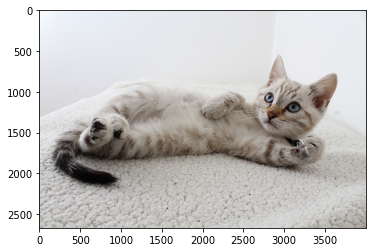

In [ ]:
image = Image.open("cat.jpg")
image.show()
plt.imshow(image)

**menampilkan properti dari objek**

In [ ]:
print(image.size)
print(image.format)
print(image.mode)

(4000, 2667)
JPEG
RGB


Text(0.5, 1.0, 'Sharpness')

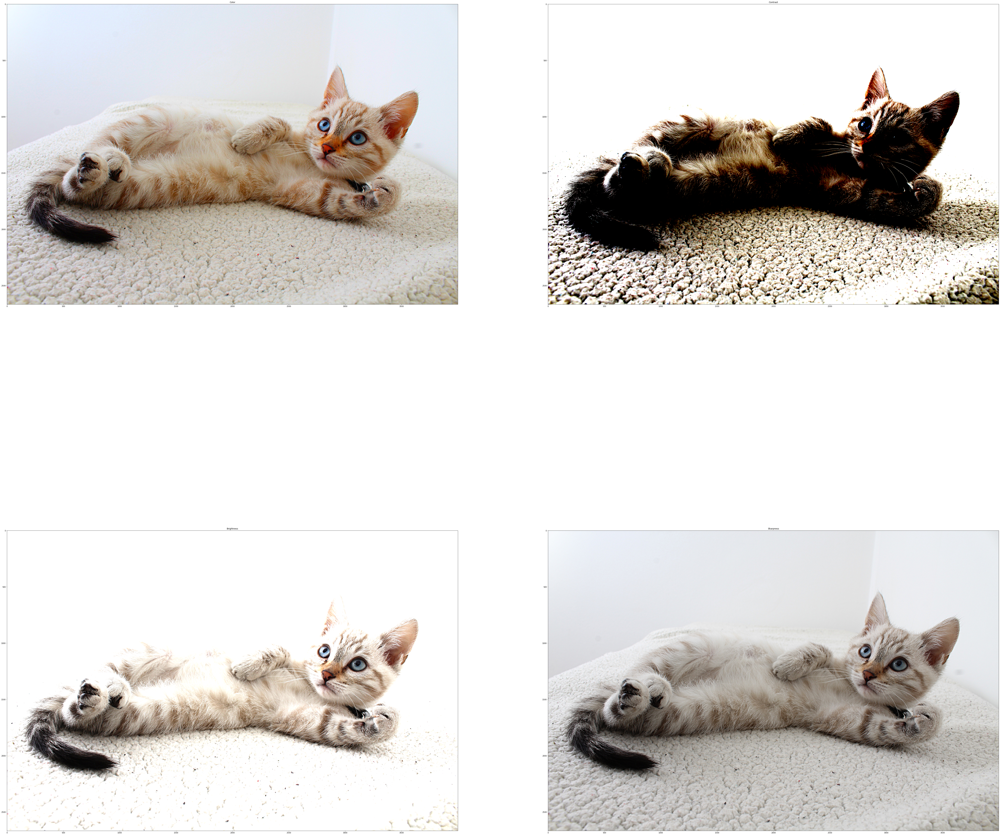

In [ ]:
from PIL import ImageEnhance
plt.figure(figsize = (100,100))
image_color_enhance = image.copy()
image1 = ImageEnhance.Color(image_color_enhance).enhance(2.5)
image2 = ImageEnhance.Contrast(image_color_enhance).enhance(5.5)
image3 = ImageEnhance.Brightness(image_color_enhance).enhance(1.0)
image4 = ImageEnhance.Sharpness(image_color_enhance).enhance(2.5)

plt.subplot(2,2,1)
plt.imshow(image1)
plt.title("Color")

plt.subplot(2,2,2)
plt.imshow(image2)
plt.title("Contrast")

plt.subplot(2,2,3)
plt.imshow(image3)
plt.title("Brightness")

plt.subplot(2,2,4)
plt.imshow(image4)
plt.title("Sharpness")

**Edge Detection**

In [ ]:
# read in the image
curved_lane = mpimg.imread('./curve_lane2.jpg')
bridge_trees = mpimg.imread('./Bridge_trees.jpg')

# check RGB image shape (it has 3 dimensions)
print('Curved lane shape:', curved_lane.shape)
print('Bridge trees shape:', bridge_trees.shape)

Curved lane shape: (667, 1000, 3)
Bridge trees shape: (682, 1024, 3)


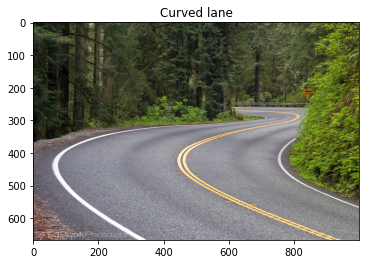

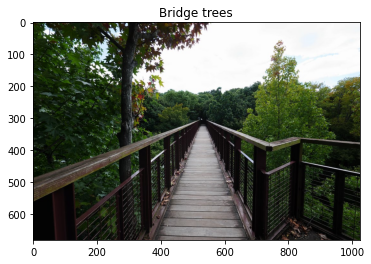

In [ ]:
plt.title('Curved lane')
plt.imshow(curved_lane)
plt.show()

plt.title('Bridge trees')
plt.imshow(bridge_trees)
plt.show()

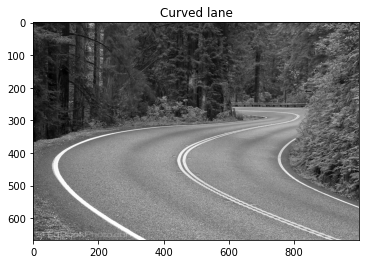

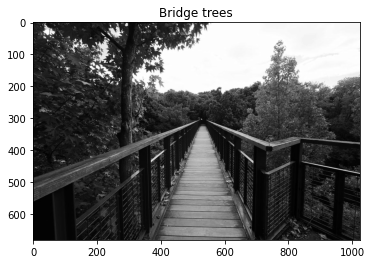

In [ ]:
# convert to grayscale for filtering
curved_lane_gray = cv2.cvtColor(curved_lane, cv2.COLOR_RGB2GRAY)
plt.title('Curved lane')
plt.imshow(curved_lane_gray, cmap='gray')
plt.show()

bridge_trees_gray = cv2.cvtColor(bridge_trees, cv2.COLOR_RGB2GRAY)
plt.title('Bridge trees')
plt.imshow(bridge_trees_gray, cmap='gray')
plt.show()

In [ ]:
# check Gray image shape (it has 1 dimension)
print('Curved lane shape:', curved_lane_gray.shape)
print('Bridge trees shape:', bridge_trees_gray.shape)

Curved lane shape: (667, 1000)
Bridge trees shape: (682, 1024)


In [ ]:
# Use Sobel kernel, 3x3 array for edge detection
# try other kernels listed here https://en.wikipedia.org/wiki/Kernel_(image_processing)

sobel_x = np.array([[-1,0,1],
                    [-2,0,2],
                    [-1,0,1]])

sobel_y = np.array([[-1, -2, -1],
                    [0, 0, 0],
                    [1, 2, 1]])

sobel_xy = sobel_x * sobel_y

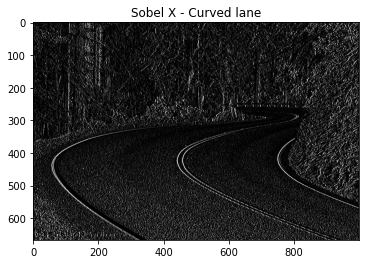

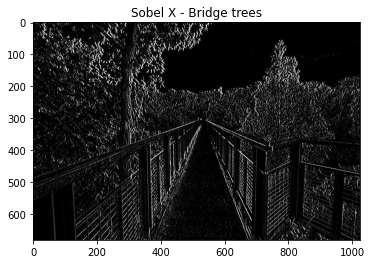

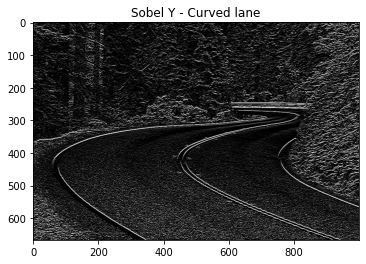

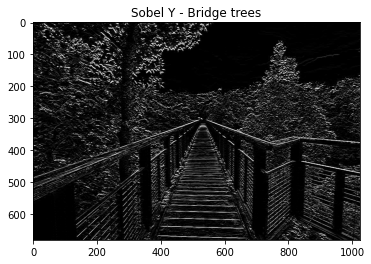

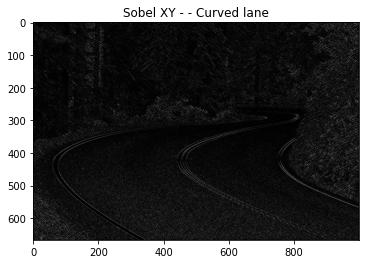

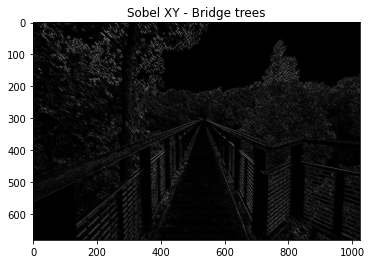

In [ ]:
# filter the image using filter2D, which has inputs: (grayscale image, bit-depth, kernel)
filtered_image = cv2.filter2D(curved_lane_gray, -1, sobel_x)
plt.title('Sobel X - Curved lane')
plt.imshow(filtered_image, cmap='gray')
plt.show()

filtered_image = cv2.filter2D(bridge_trees_gray, -1, sobel_x)
plt.title('Sobel X - Bridge trees')
plt.imshow(filtered_image, cmap='gray')
plt.show()

filtered_image = cv2.filter2D(curved_lane_gray, -1, sobel_y)
plt.title('Sobel Y - Curved lane')
plt.imshow(filtered_image, cmap='gray')
plt.show()

filtered_image = cv2.filter2D(bridge_trees_gray, -1, sobel_y)
plt.title('Sobel Y - Bridge trees')
plt.imshow(filtered_image, cmap='gray')
plt.show()

filtered_image = cv2.filter2D(curved_lane_gray, -1, sobel_xy)
plt.title('Sobel XY - - Curved lane')
plt.imshow(filtered_image, cmap='gray')
plt.show()

filtered_image = cv2.filter2D(bridge_trees_gray, -1, sobel_xy)
plt.title('Sobel XY - Bridge trees')
plt.imshow(filtered_image, cmap='gray')
plt.show()

## Load image from drive and shows the original image.

### **imshow**:
Function that handles both rgb and grayscale image and shows them accordingly.

*Parameters*:
- **img**: input img

*Return*: None

(512, 512, 1)


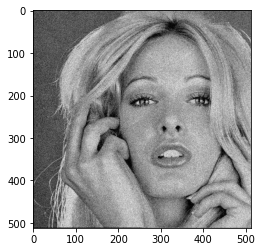

In [ ]:

img = mpimg.imread("original.jpg")

def imshow(img):
    if len(img.shape) < 3:
        plt.imshow(img, cmap="gray")
    elif img.shape[2] == 1:
        plt.imshow(np.resize(img,(img.shape[0],img.shape[1])), cmap="gray")
    else:
        plt.imshow(img)


if len(img.shape) < 3:
    img.resize(*img.shape,1)

imshow(img)

print(img.shape)

## Low Pass, High Pass and Gaussian Filter

### gfunc:

Implementation of gaussian function

*Parameters*:

- **x, y and sigma**(double): gaussian function parameters

*Return*:

- Scaler value at x,y for sigma of gaussian function

### gaussFilter:
Function that applies gaussian filter to an image

*Parameters*:
- **size**(tuple): size of gaussian filter
-  **sigma**(double): parameter of gaussian function

*Return*:

- Gaussian Filter(2d matrix)

In [ ]:

# low pass filter
(lpfw,lpfh) = (3,3)
lowPassFilter = np.ones((lpfw,lpfh))*1/(lpfw*lpfh)


# high pass filter
(hpfw,hpfh) = (3,3)
highPassFilter = -1*np.ones((hpfw,hpfh))
highPassFilter[hpfw//2,hpfh//2] = -np.sum(highPassFilter)-1


# gaussian filter
def gfunc(x,y,sigma):
    return (math.exp(-(x**2 + y**2)/(2*(sigma**2))))/(2*3.14*(sigma**2))

def gaussFilter(size, sigma):
    out = np.zeros(size)
    for i in range(size[0]):
        for j in range(size[1]):
            out[i,j] = gfunc(i-size[0]//2,j-size[1]//2, sigma )
    return out/np.sum(out)

(gfw,gfh) = (3,3)
gaussianFilter = gaussFilter((gfw,gfh),1)

print("Low Pass Filter")
print(lowPassFilter)

print("High Pass Filter")
print(highPassFilter)

print("Gaussian Filter")
print(gaussianFilter)

Low Pass Filter
[[0.11111111 0.11111111 0.11111111]
 [0.11111111 0.11111111 0.11111111]
 [0.11111111 0.11111111 0.11111111]]
High Pass Filter
[[-1. -1. -1.]
 [-1.  8. -1.]
 [-1. -1. -1.]]
Gaussian Filter
[[0.07511361 0.1238414  0.07511361]
 [0.1238414  0.20417996 0.1238414 ]
 [0.07511361 0.1238414  0.07511361]]


## Example of Low Pass and Gaussian Filter

### conv
Function that applies convolution to an 2d/3d matrix or numpy array on the given filter

*Parameters*:

- **image** (2d/3d matrix): image on which convolution will be applied with given filter
- **filter** (2d matrix): filter which will applied to image

*Return*:

- filtered image(2d/3d matrix)

 ========================================= Low Pass Filter =========================================


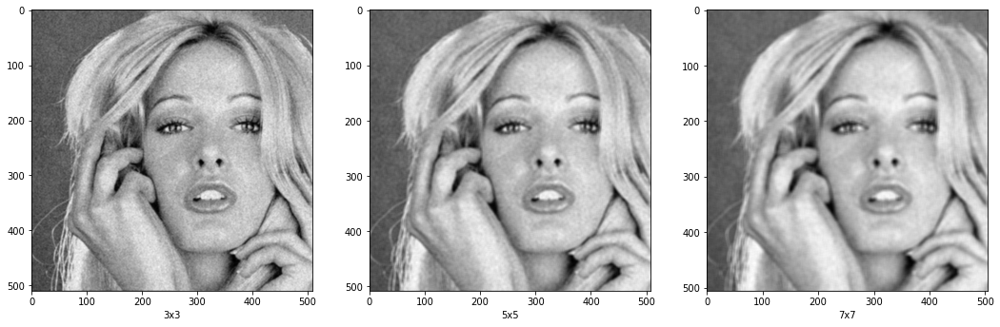

 ========================================= High Pass Filter =========================================


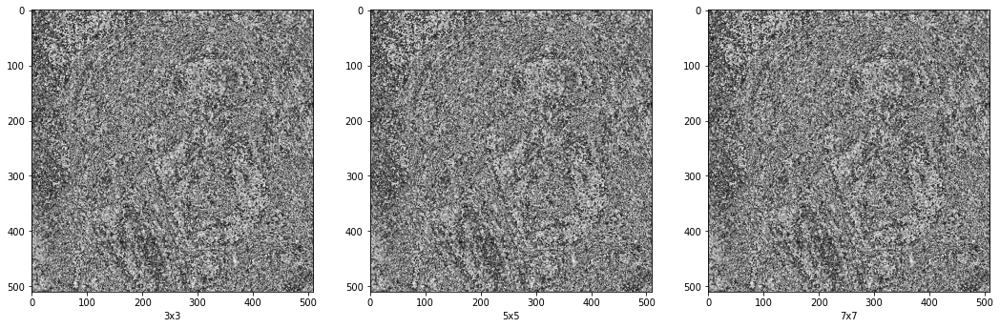


 ========================================= Gaussian Filter =========================================


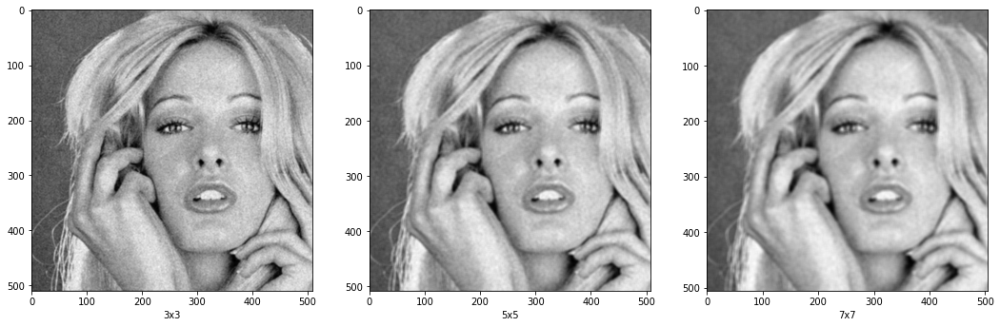

In [ ]:
def conv(image, filter):
    iw,ih,id = image.shape

    fw,fh = filter.shape
    out = np.zeros((iw-fw+1,ih-fh+1,id))

    for d in range(id):
        for w in range(ih-fh+1):
            for h in range(iw-fw+1):
                out[w,h,d] = np.sum(filter*image[w:w+fh , h:h+fw , d])

    if id == 1:
        return np.resize(out, (out.shape[0], out.shape[1])).astype(np.uint8)
    else:
        return out.astype(np.uint8)




fig = plt.figure(1, figsize=(18, 16))
print(" ========================================= Low Pass Filter =========================================")
for i in range(3,8,2):
    splot = plt.subplot(130-1+((i+1)//2))
    splot.set_xlabel(str(i)+"x"+str(i))
    (lpfw,lpfh) = (i,i)
    lowPassFilter = np.ones((lpfw,lpfh))*1/(lpfw*lpfh)
    low_image = conv(img, lowPassFilter)
    imshow(low_image)
    cv2.imwrite("low"+str(i)+"x"+str(i)+".jpg",low_image)
plt.show()

fig = plt.figure(2, figsize=(18, 16))
print(" ========================================= High Pass Filter =========================================")
for i in range(3,8,2):
    splot = plt.subplot(130-1+((i+1)//2))
    splot.set_xlabel(str(i)+"x"+str(i))
    (lpfw,lpfh) = (i,i)
    highPassFilter = -1*np.ones((hpfw,hpfh))
    high_image = conv(img, highPassFilter)
    imshow(high_image)
    cv2.imwrite("High"+str(i)+"x"+str(i)+".jpg",high_image)
plt.show()


print()
fig = plt.figure(3, figsize=(18, 16))
print(" ========================================= Gaussian Filter =========================================")
for i in range(3,8,2):
    splot = plt.subplot(130-1+((i+1)//2))
    splot.set_xlabel(str(i)+"x"+str(i))
    (gfw,gfh) = (i,i)
    gaussianFilter = gaussFilter((gfw,gfh),4)
    gaussian_image = conv(img, gaussianFilter)
    imshow(gaussian_image)
    cv2.imwrite("gaussian"+str(i)+"x"+str(i)+".jpg",gaussian_image)
plt.show()
